In [ ]:
# delta chi2 vs lambda
# agn to total as a function of wavelength
# can fit the resulting fits with eazy as a function of wavelength

In [266]:
import os
from glob import glob
from tqdm import tqdm
import importlib
from astropy.table import Table
import numpy as np

import matplotlib.pyplot as plt
from matplotlib.ticker import MultipleLocator, AutoMinorLocator

import matplotlib
matplotlib.use('Agg')
matplotlib.rc('font', family='serif', serif='cm')
matplotlib.rc('text', usetex=True)
matplotlib.rc('ps', usedistiller='xpdf')
%matplotlib inline


In [267]:
filters = ['f090w', 'f115w', 'f150w', 'f200w', 'f277w', 'f356w', 'f410m', 'f444w']
flamb = [0.901, 1.154, 1.501, 1.990, 2.786, 3.563, 4.092, 4.421]

In [268]:
def plot_single_sersic(spoke, obj, num='01'):
    sersic, re, mag, chi2 = [], [], [], []
    wavelengths = []

    # get results from the object
    for filt, lamb in zip(filters, flamb):
        if not os.path.isfile(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/{filt}/galfit.{num}'):                    
            continue
            
        with open(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/{filt}/galfit.{num}', 'r') as f:
            for line in f:
                if 'Chi^2/nu' in line:
                    chi2.append(float(line.split()[3][:-1]))
                if ' 3)' in line:
                    mag.append(float(line.split()[1]))
                if ' 4)' in line:
                    re.append(float(line.split()[1]))
                if ' 5)' in line:
                    sersic.append(float(line.split()[1]))

        wavelengths.append(lamb)

    # plot results

    fig, ax = plt.subplots(2, 2)    
    fig.set_size_inches(12, 10)
    ax = ax.ravel()

    ax[0].plot(wavelengths, mag, color='black', ls='-', lw=2)
    ax[0].set_xlabel('$\lambda$ [$\mu$m]', fontsize=15)
    ax[0].set_ylabel('mag [AB]', fontsize=15)
    ax[0].invert_yaxis()
    
    ax[1].plot(wavelengths, chi2, color='black', ls='-', lw=2)
    ax[1].set_xlabel('$\lambda$ [$\mu$m]', fontsize=15)
    ax[1].set_ylabel(r'$\chi^2_{\nu}$', fontsize=15)
    
    ax[2].plot(wavelengths, re, color='black', ls='-', lw=2)
    ax[2].set_xlabel('$\lambda$ [$\mu$m]', fontsize=15)
    ax[2].set_ylabel(r'half-light radius $r_e$ [pix]', fontsize=15)
    
    ax[3].plot(wavelengths, sersic, color='black', ls='-', lw=2)
    ax[3].set_xlabel('$\lambda$ [$\mu$m]', fontsize=15)
    ax[3].set_ylabel(r'sersic index $n$', fontsize=15)
    
    ml1 = MultipleLocator(0.25)

    ml2 = AutoMinorLocator(n=2)
    ml3 = AutoMinorLocator(n=2)
    ml4 = AutoMinorLocator(n=2)
    ml5 = AutoMinorLocator(n=2)
    
    ax[0].xaxis.set_minor_locator(ml1)
    ax[1].xaxis.set_minor_locator(ml1)
    ax[2].xaxis.set_minor_locator(ml1)
    ax[3].xaxis.set_minor_locator(ml1)
    
    ax[0].yaxis.set_minor_locator(ml2)
    ax[1].yaxis.set_minor_locator(ml3)
    ax[2].yaxis.set_minor_locator(ml4)
    ax[3].yaxis.set_minor_locator(ml5)

    for axis in ax:
        axis.tick_params(axis='both', which='major', length=10, width=1, direction='in', labelsize='large', 
                         bottom=True, top=True, left=True, right=True)
        axis.tick_params(axis='both', which='minor', length=5, width=1, direction='in', labelsize='large', 
                         bottom=True, top=True, left=True, right=True)
    
    fig.savefig(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/sersic_results/galfit_results_sersic.pdf', bbox_inches='tight')
    

In [269]:
def plot_single_psf(spoke, obj, num='02'):
    mag, chi2 = [], []
    wavelengths = []

    # get results from the object
    for filt, lamb in zip(filters, flamb):
        if not os.path.isfile(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/{filt}/galfit.{num}'):
            continue
            
        with open(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/{filt}/galfit.{num}', 'r') as f:
            for line in f:
                if 'Chi^2/nu' in line:
                    chi2.append(float(line.split()[3][:-1]))
                if ' 3)' in line:
                    mag.append(float(line.split()[1]))

        wavelengths.append(lamb)

    # plot results

    fig, ax = plt.subplots(1, 2)    
    fig.set_size_inches(12, 5)

    ax[0].plot(wavelengths, mag, color='black', ls='-', lw=2)
    ax[0].set_xlabel('$\lambda$ [$\mu$m]', fontsize=15)
    ax[0].set_ylabel('mag [AB]', fontsize=15)
    ax[0].invert_yaxis()
    
    ax[1].plot(wavelengths, chi2, color='black', ls='-', lw=2)
    ax[1].set_xlabel('$\lambda$ [$\mu$m]', fontsize=15)
    ax[1].set_ylabel(r'$\chi^2_{\nu}$', fontsize=15)
        
    ml1 = MultipleLocator(0.25)

    ml2 = AutoMinorLocator(n=2)
    ml3 = AutoMinorLocator(n=2)
    
    ax[0].xaxis.set_minor_locator(ml1)
    ax[1].xaxis.set_minor_locator(ml1)
    
    ax[0].yaxis.set_minor_locator(ml2)
    ax[1].yaxis.set_minor_locator(ml3)

    for axis in ax:
        axis.tick_params(axis='both', which='major', length=10, width=1, direction='in', labelsize='large', 
                         bottom=True, top=True, left=True, right=True)
        axis.tick_params(axis='both', which='minor', length=5, width=1, direction='in', labelsize='large', 
                         bottom=True, top=True, left=True, right=True)
    
    fig.savefig(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/sersic_results/galfit_results_psf.pdf', bbox_inches='tight')
    

In [270]:
def plot_double_sersic(spoke, obj, num='03'):
    sersic1, re1, mag1, sersic2, re2, mag2, chi2 = [], [], [], [], [], [], []
    wavelengths = []

    # get results from the object
    for filt, lamb in zip(filters, flamb):
        if not os.path.isfile(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/{filt}/galfit.{num}'):
            continue
            
        with open(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/{filt}/galfit.{num}', 'r') as f:
            mag = 1
            ser = 1
            re  = 1
            for line in f:
                if 'Chi^2/nu' in line:
                    chi2.append(float(line.split()[3][:-1]))
                elif ' 3)' in line and mag == 1:
                    mag1.append(float(line.split()[1]))
                    mag += 1
                elif ' 4)' in line and re == 1:
                    re1.append(float(line.split()[1]))
                    re += 1
                elif ' 5)' in line and ser == 1:
                    sersic1.append(float(line.split()[1]))
                    ser += 1
                elif ' 3)' in line and mag == 2:
                    mag2.append(float(line.split()[1]))
                elif ' 4)' in line and re == 2:
                    re2.append(float(line.split()[1]))
                elif ' 5)' in line and ser == 2:
                    sersic2.append(float(line.split()[1]))

        wavelengths.append(lamb)

    # plot results

    fig, ax = plt.subplots(2, 2)    
    fig.set_size_inches(12, 10)
    ax = ax.ravel()

    ax[0].plot(wavelengths, mag1, color='black', ls='-', lw=2)
    ax[0].plot(wavelengths, mag2, color='blue', ls='--', lw=2)
    ax[0].set_xlabel('$\lambda$ [$\mu$m]', fontsize=15)
    ax[0].set_ylabel('mag [AB]', fontsize=15)
    ax[0].invert_yaxis()
    
    ax[1].plot(wavelengths, chi2, color='black', ls='-', lw=2)
    ax[1].set_xlabel('$\lambda$ [$\mu$m]', fontsize=15)
    ax[1].set_ylabel(r'$\chi^2_{\nu}$', fontsize=15)
    
    ax[2].plot(wavelengths, re1, color='black', ls='-', lw=2)
    ax[2].plot(wavelengths, re2, color='blue', ls='--', lw=2)
    ax[2].set_xlabel('$\lambda$ [$\mu$m]', fontsize=15)
    ax[2].set_ylabel(r'half-light radius $r_e$ [pix]', fontsize=15)
    
    ax[3].plot(wavelengths, sersic1, color='black', ls='-', lw=2)
    ax[3].plot(wavelengths, sersic2, color='blue', ls='--', lw=2)
    ax[3].set_xlabel('$\lambda$ [$\mu$m]', fontsize=15)
    ax[3].set_ylabel(r'sersic index $n$', fontsize=15)
    
    ml1 = MultipleLocator(0.25)

    ml2 = AutoMinorLocator(n=2)
    ml3 = AutoMinorLocator(n=2)
    ml4 = AutoMinorLocator(n=2)
    ml5 = AutoMinorLocator(n=2)
    
    ax[0].xaxis.set_minor_locator(ml1)
    ax[1].xaxis.set_minor_locator(ml1)
    ax[2].xaxis.set_minor_locator(ml1)
    ax[3].xaxis.set_minor_locator(ml1)
    
    ax[0].yaxis.set_minor_locator(ml2)
    ax[1].yaxis.set_minor_locator(ml3)
    ax[2].yaxis.set_minor_locator(ml4)
    ax[3].yaxis.set_minor_locator(ml5)

    for axis in ax:
        axis.tick_params(axis='both', which='major', length=10, width=1, direction='in', labelsize='large', 
                         bottom=True, top=True, left=True, right=True)
        axis.tick_params(axis='both', which='minor', length=5, width=1, direction='in', labelsize='large', 
                         bottom=True, top=True, left=True, right=True)
    
    fig.savefig(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/sersic_results/galfit_results_2sersic.pdf', bbox_inches='tight')
    

In [271]:
def plot_sersic_psf(spoke, obj, num='04'):
    sersic1, re1, mag1, mag2, chi2 = [], [], [], [], []
    wavelengths = []

    # get results from the object
    for filt, lamb in zip(filters, flamb):
        if not os.path.isfile(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/{filt}/galfit.{num}'):
            continue
            
        with open(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/{filt}/galfit.{num}', 'r') as f:
            mag = 1
            ser = 1
            re = 1
            for line in f:
                if 'Chi^2/nu' in line:
                    chi2.append(float(line.split()[3][:-1]))
                elif ' 3)' in line and mag == 1:
                    mag1.append(float(line.split()[1]))
                    mag += 1
                elif ' 4)' in line and re == 1:
                    re1.append(float(line.split()[1]))
                    re += 1
                elif ' 5)' in line and ser == 1:
                    sersic1.append(float(line.split()[1]))
                    ser += 1
                elif ' 3)' in line and mag == 2:
                    mag2.append(float(line.split()[1]))

        wavelengths.append(lamb)

    # plot results

    fig, ax = plt.subplots(2, 2)    
    fig.set_size_inches(12, 10)
    ax = ax.ravel()

    ax[0].plot(wavelengths, mag1, color='black', ls='-', lw=2)
    ax[0].plot(wavelengths, mag2, color='blue', ls='--', lw=2)
    ax[0].set_xlabel('$\lambda$ [$\mu$m]', fontsize=15)
    ax[0].set_ylabel('mag [AB]', fontsize=15)
    ax[0].invert_yaxis()
    
    ax[1].plot(wavelengths, chi2, color='black', ls='-', lw=2)
    ax[1].set_xlabel('$\lambda$ [$\mu$m]', fontsize=15)
    ax[1].set_ylabel(r'$\chi^2_{\nu}$', fontsize=15)
    
    ax[2].plot(wavelengths, re1, color='black', ls='-', lw=2)
    ax[2].set_xlabel('$\lambda$ [$\mu$m]', fontsize=15)
    ax[2].set_ylabel(r'half-light radius $r_e$ [pix]', fontsize=15)
    
    ax[3].plot(wavelengths, sersic1, color='black', ls='-', lw=2)
    ax[3].set_xlabel('$\lambda$ [$\mu$m]', fontsize=15)
    ax[3].set_ylabel(r'sersic index $n$', fontsize=15)
    
    ml1 = MultipleLocator(0.25)

    ml2 = AutoMinorLocator(n=2)
    ml3 = AutoMinorLocator(n=2)
    ml4 = AutoMinorLocator(n=2)
    ml5 = AutoMinorLocator(n=2)
    
    ax[0].xaxis.set_minor_locator(ml1)
    ax[1].xaxis.set_minor_locator(ml1)
    ax[2].xaxis.set_minor_locator(ml1)
    ax[3].xaxis.set_minor_locator(ml1)
    
    ax[0].yaxis.set_minor_locator(ml2)
    ax[1].yaxis.set_minor_locator(ml3)
    ax[2].yaxis.set_minor_locator(ml4)
    ax[3].yaxis.set_minor_locator(ml5)

    for axis in ax:
        axis.tick_params(axis='both', which='major', length=10, width=1, direction='in', labelsize='large', 
                         bottom=True, top=True, left=True, right=True)
        axis.tick_params(axis='both', which='minor', length=5, width=1, direction='in', labelsize='large', 
                         bottom=True, top=True, left=True, right=True)
    
    fig.savefig(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/sersic_results/galfit_results_sersic_psf.pdf', bbox_inches='tight')
    

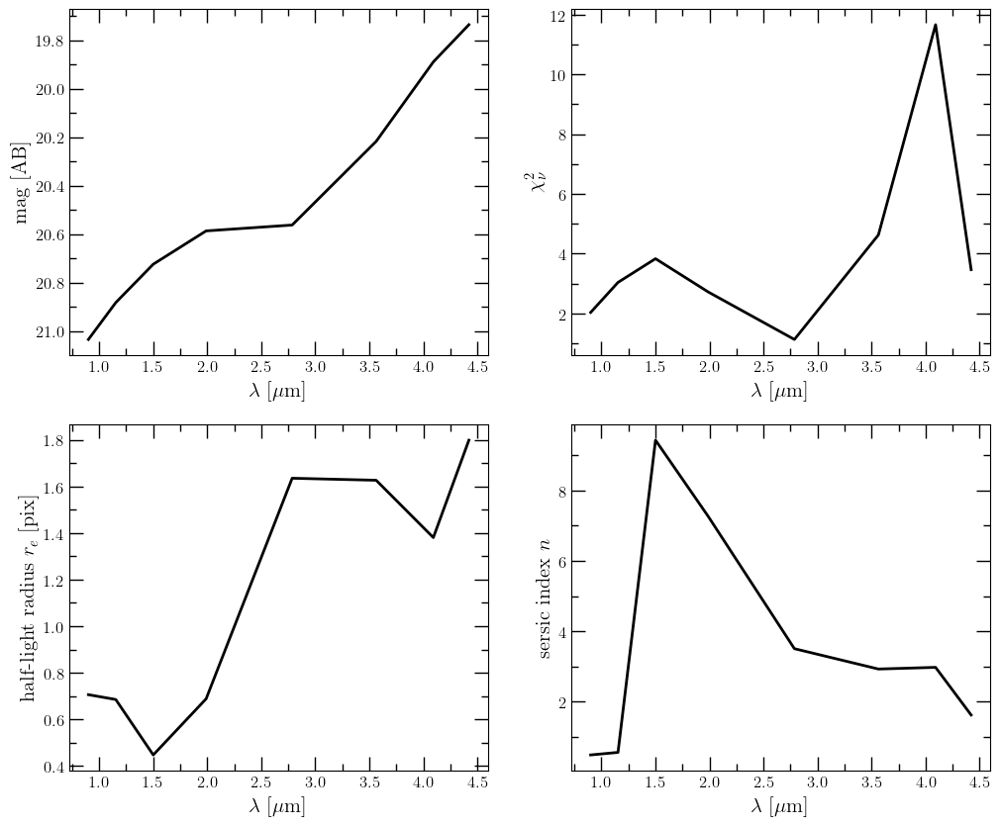

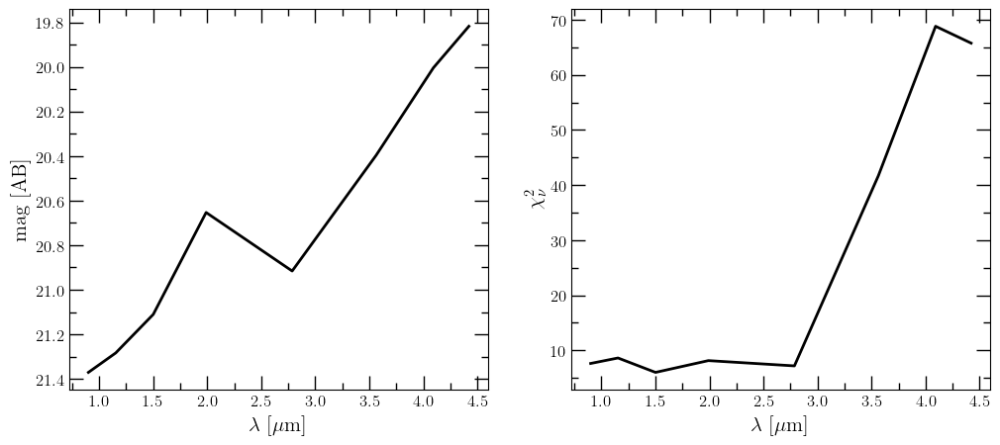

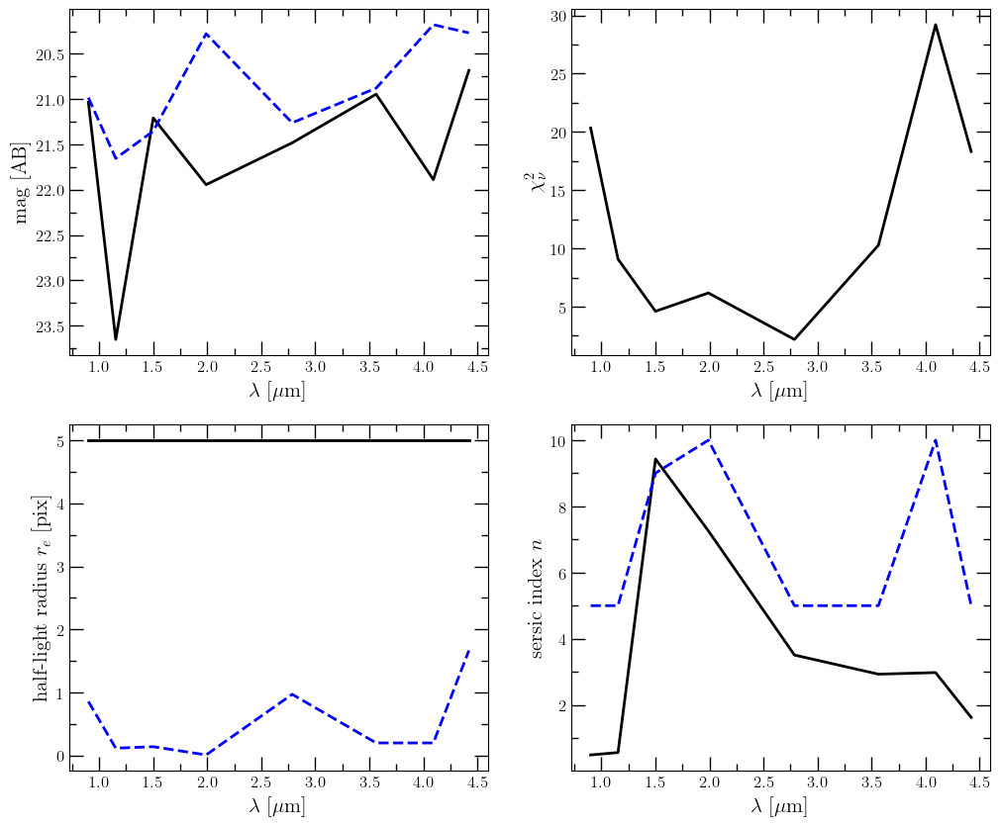

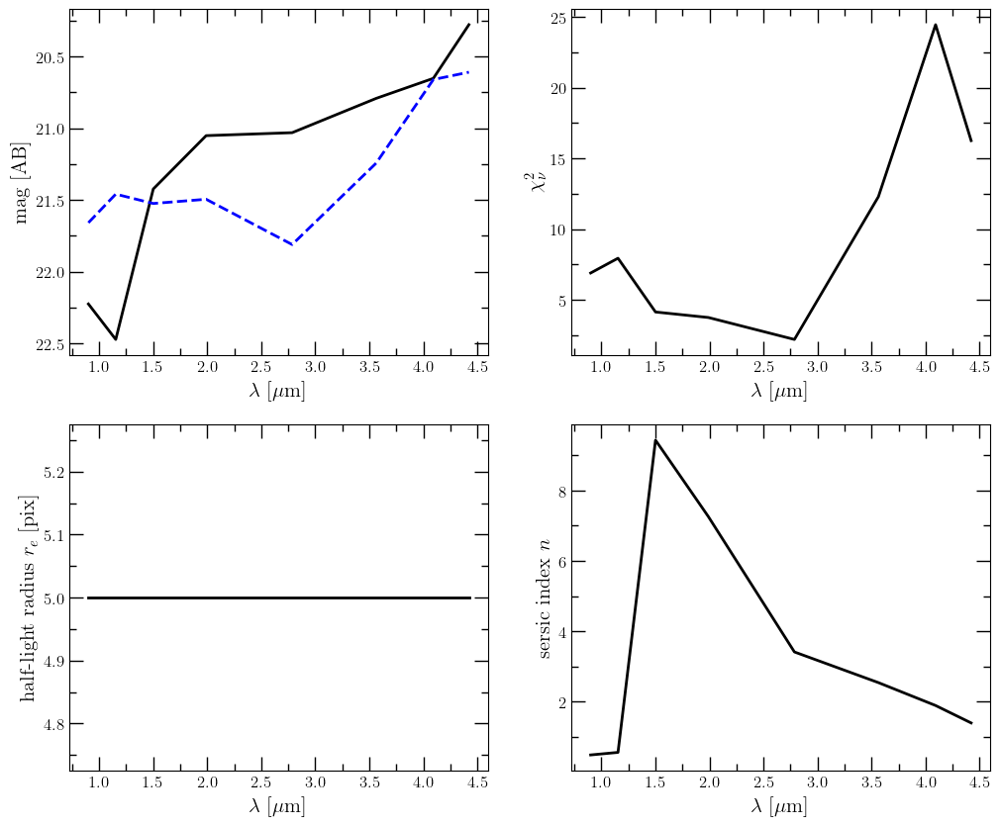

In [272]:
obj_id = 8846
spoke = 'spoke4'
plot_single_sersic(spoke, obj_id, num='01')
plot_single_psf(spoke, obj_id, num='02')
plot_double_sersic(spoke, obj_id, num='03')
plot_sersic_psf(spoke, obj_id, num='04')

In [250]:
def plot_chi2_all(obj_list):
    chi2_ds, chi2_sp = {}, {}
    ds, sp = {}, {}

    for filt in filters:
        chi2_ds[filt] = []
        chi2_sp[filt] = []

    for i in range(len(obj_list)):
        obj = obj_list[i][1]
        spoke = obj_list[i][0]
        for filt in filters:
            if not os.path.isfile(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/{filt}/galfit.03'):
                continue
            if not os.path.isfile(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/{filt}/galfit.04'):
                continue
                
            with open(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/{filt}/galfit.03', 'r') as f:
                for line in f:
                    if 'Chi^2/nu' in line:
                        chi2_ds[filt].append(float(line.split()[3][:-1]))
            with open(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/objects/{spoke}/obj_{obj}/{filt}/galfit.04', 'r') as f:
                for line in f:
                    if 'Chi^2/nu' in line:
                        chi2_sp[filt].append(float(line.split()[3][:-1]))

    # plot results

    fig, ax = plt.subplots(2, 4, sharex=True, sharey=True)    
    fig.set_size_inches(14, 7)
    fig.subplots_adjust(wspace=0, hspace=0)
    ax = ax.ravel()

    for i in range(len(filters)):
        ax[i].set_xlim(0.2, 300)
        ax[i].set_ylim(0.2, 300)
        ax[i].set_xscale('log')
        ax[i].set_yscale('log')
        
        ax[i].scatter(chi2_ds[filters[i]], chi2_sp[filters[i]], color='black', s=2)
        ax[i].plot([0,300], [0,300], ls='-', lw=0.5, color='black')
        ax[i].text(0.3, 130, filters[i].upper(), fontsize=15)

        pref_ds = len(np.where(np.array(chi2_ds[filters[i]]) < np.array(chi2_sp[filters[i]]))[0])
        pref_sp = len(np.where(np.array(chi2_sp[filters[i]]) <= np.array(chi2_ds[filters[i]]))[0])
        
        ax[i].text(0.32, 11.2, f'{pref_ds} objects', fontsize=12, rotation='vertical')
        ax[i].text(11.2, 0.32, f'{pref_sp} objects', fontsize=12)
    
    fig.supxlabel(r'sersic $+$ sersic $\chi^2_{\nu}$', fontsize=20, y=0.04)
    fig.supylabel(r'sersic $+$ psf $\chi^2_{\nu}$', fontsize=20, x=0.08)
        

    aml = AutoMinorLocator(n=2)

    for i in range(8):
        pass
        #ax[i].xaxis.set_minor_locator(aml)
        #ax[i].yaxis.set_minor_locator(aml)

    for axis in ax:
        axis.tick_params(axis='both', which='major', length=10, width=1, direction='in', labelsize='large', 
                         bottom=True, top=True, left=True, right=True)
        axis.tick_params(axis='both', which='minor', length=5, width=1, direction='in', labelsize='large', 
                         bottom=True, top=True, left=True, right=True)
    
    fig.savefig(f'/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/results/chi2_comparison.pdf', bbox_inches='tight')
    

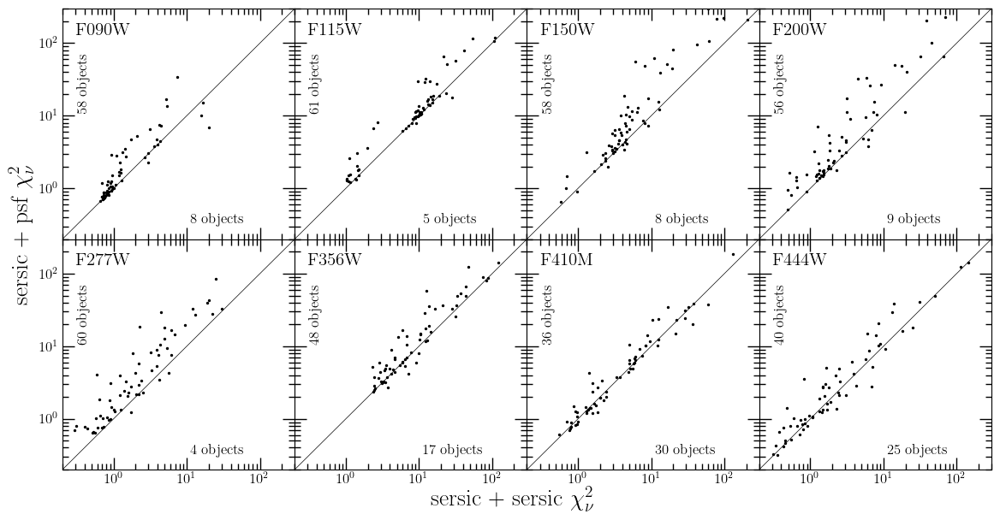

In [251]:
object_list = Table.read('/Users/jakesummers7200/JWST/PEARLS/PSFAGN-morphology/neptdf/cats/cpg_objects.txt', format='ascii')
object_list = list(np.array((object_list)))

plot_chi2_all(object_list)

/var/folders/02/0r851hhj6xxcvp48_3vzfpg80000gn/T/ipykernel_37829/3778904991.py:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(2, 2)


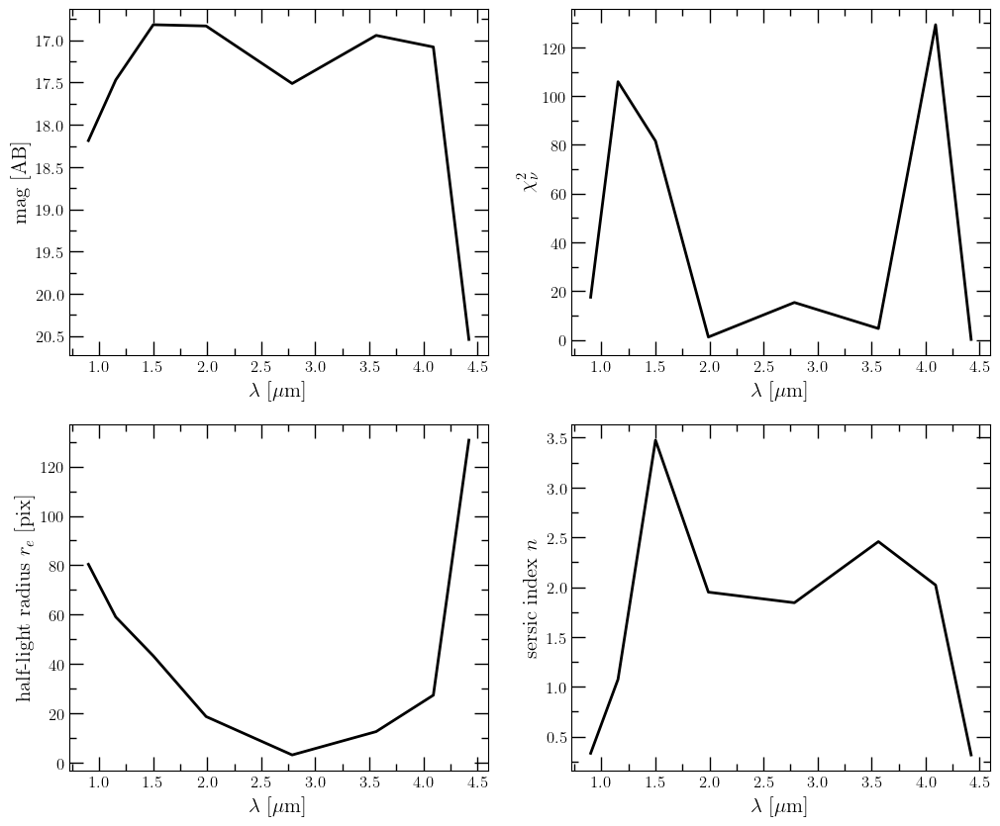

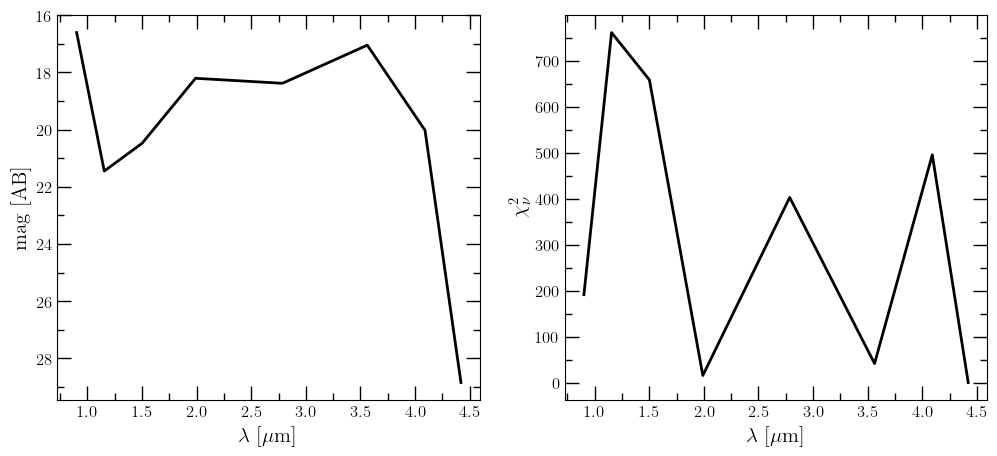

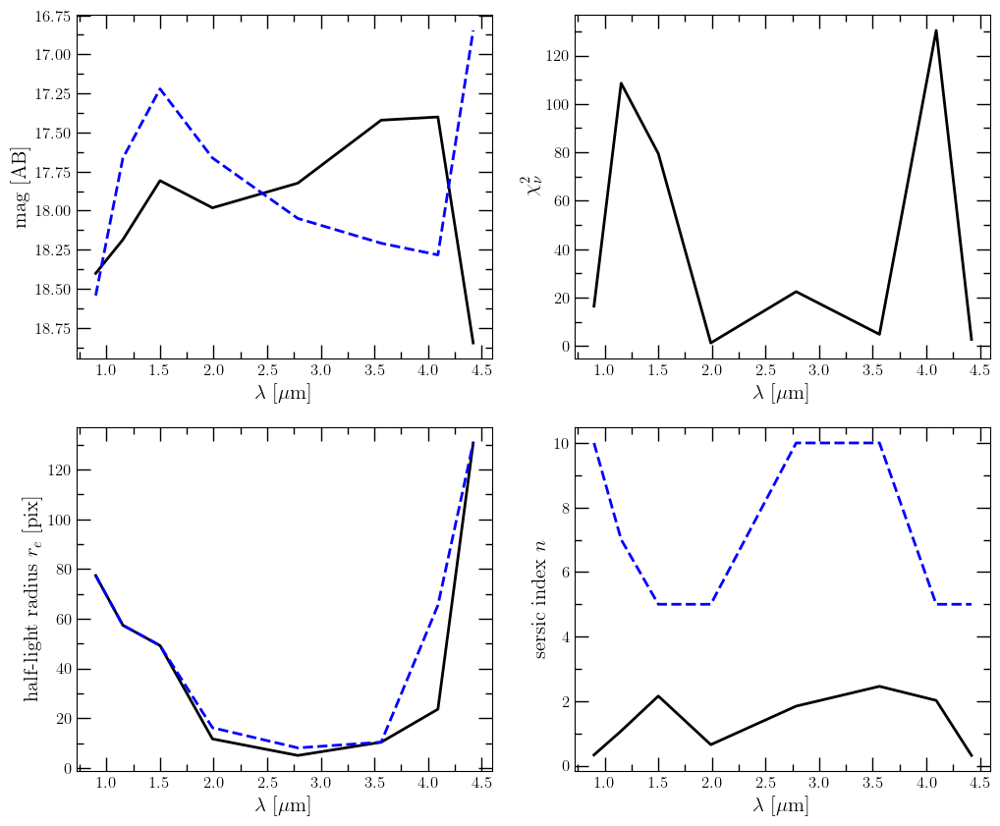

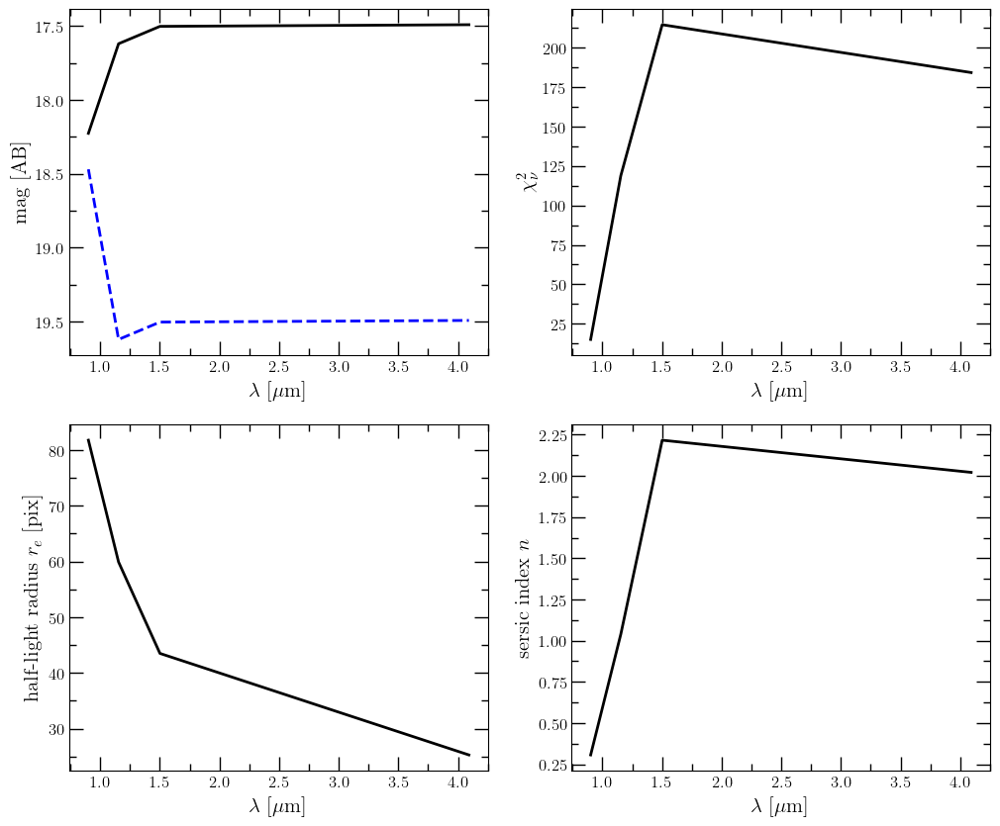

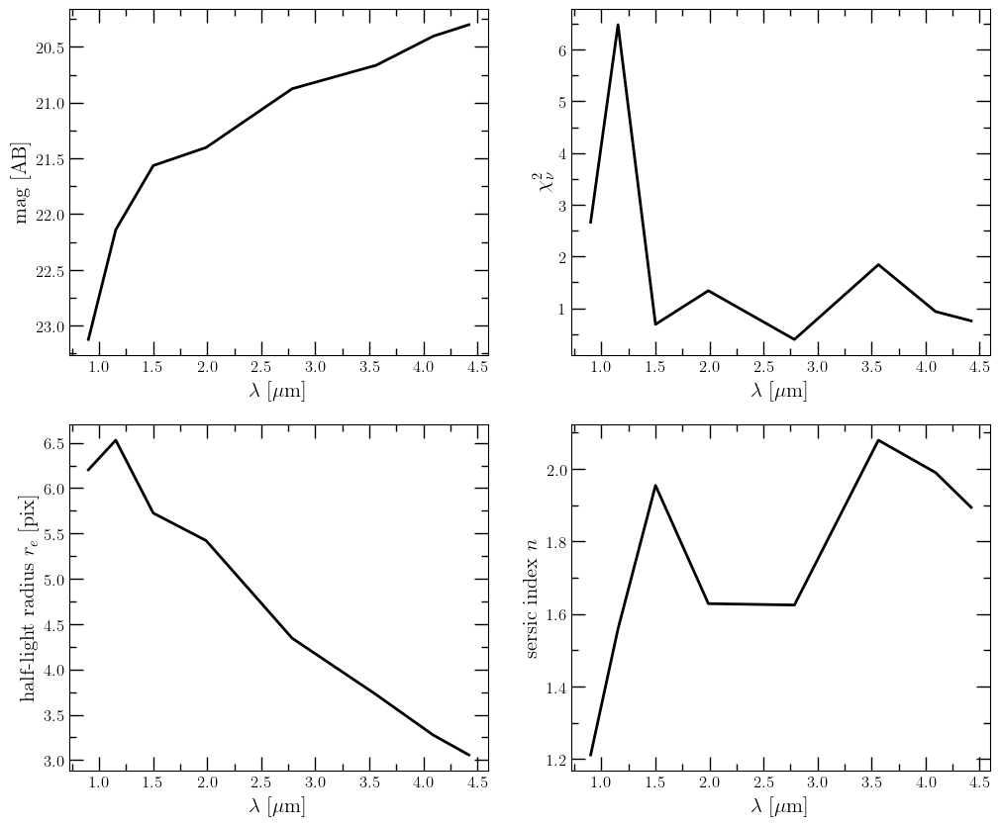

...

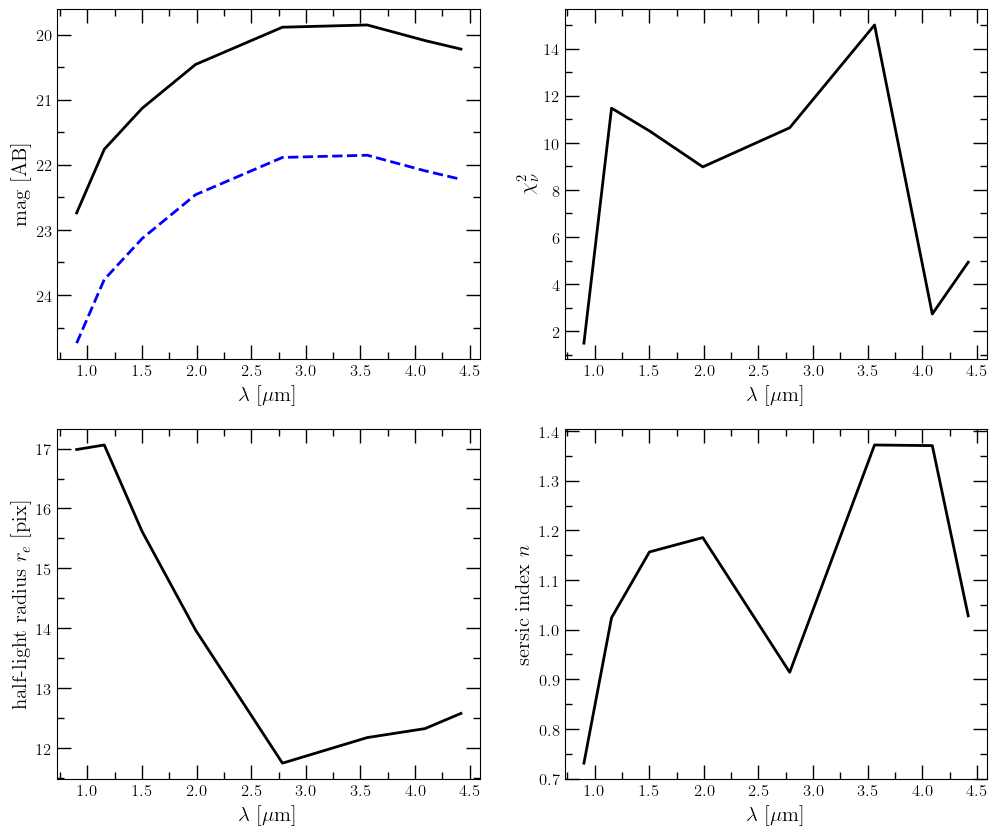

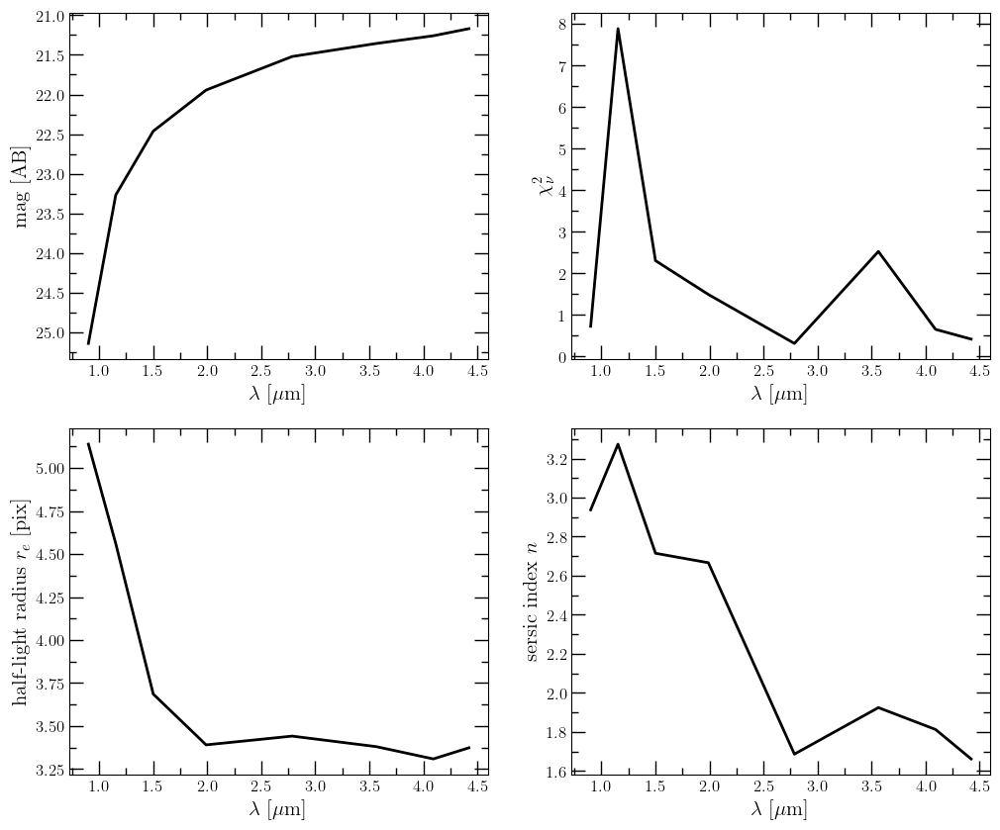

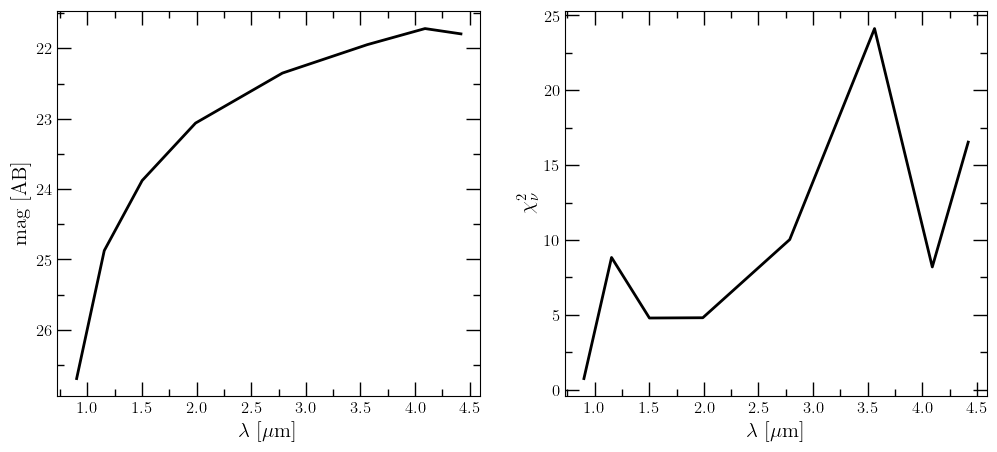

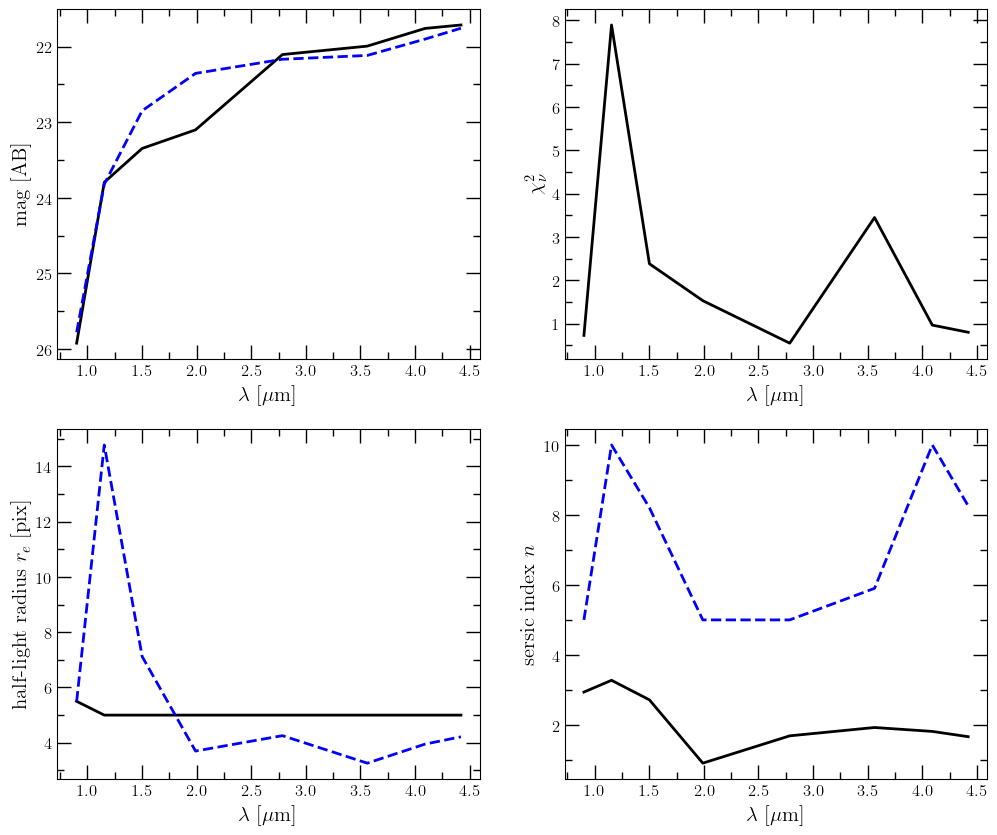

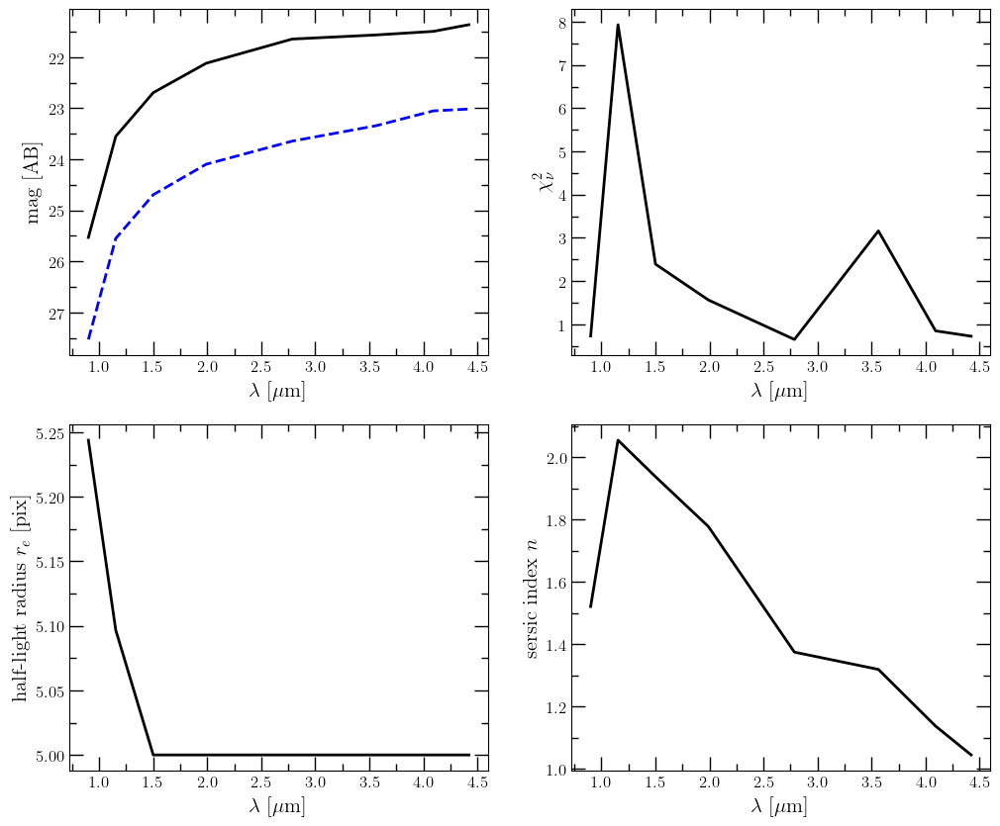

In [273]:
for i in range(len(object_list)):
    obj_id = object_list[i][1]
    spoke = object_list[i][0]
    plot_single_sersic(spoke, obj_id, num='01')
    plot_single_psf(spoke, obj_id, num='02')
    plot_double_sersic(spoke, obj_id, num='03')
    plot_sersic_psf(spoke, obj_id, num='04')